In [252]:
# -*- coding: utf-8 -*-
"""
Copyright (c) 2018 Silixa Ltd
Permission is hereby granted, free of charge, to any person obtaining a copy of this software and associated documentation
files (the "Software"), to use the Software for the sole purpose of private, non-commercial use and/or in-house company
research and development meaning the right to use, copy, modify, merge, share the Software, and to permit persons to whom
the Software is furnished to like-wise do so, subject to the following conditions:
The above copyright notice and this permission notice shall be included in all copies or substantial portions of the Software.
For any intended commercial use then contact the copyright holder, Silixa Ltd, for permission, which shall not be unreasonably
withheld.
THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES
OF MERCHANTABILITY, FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE AUTHORS OR COPYRIGHT HOLDERS BE
LIABLE FOR ANY CLAIM, DAMAGES OR OTHER LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM, OUT OF OR
IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE SOFTWARE.

$Rev:: 26283                                                                  $
$Date:: 2018-03-27 13:14:05 +0100 (Tue, 27 Mar 2018)                          $

Ref:    [1] TDMS_Adv_Read.m
        [2] http://www.ni.com/white-paper/5696/en#toc2

"""

import os, struct, datetime
import pandas as pd
import numpy as np
import mmap

def load_property_map(xls_file):
    prop_map = pd.read_excel(xls_file, sheetname='Sheet1')
    return prop_map[['CurrentTag', 'CorrectTag']].applymap(lambda x: x.replace(" ", "")).set_index('CurrentTag').to_dict()['CorrectTag']

#prop_map = load_property_map('MetaDataTable_iDAS_TDMS_CFG_Tags.xlsx')

def write_property_dict(prop_dict, out_file):
    from pprint import pformat
    f = open(out_file, 'w')
    f.write('tdms_property_map=')
    f.write(pformat(prop_dict))
    f.close()

def type_not_supported(vargin):
    """Function raises a NotImplementedException."""
    raise NotImplementedError("Reading of this tdsDataType is not implemented")


def parse_time_stamp(fractions, seconds):
    """
    Convert time TDMS time representation to datetime
    fractions   -- fractional seconds (2^-64)
    seconds     -- The number of seconds since 1/1/1904
    @rtype : datetime.datetime
    """
    if fractions is not None and seconds is not None and fractions + seconds > 0:
        return datetime.timedelta(0, fractions * 2 ** -64 + seconds) + \
               datetime.datetime(1904, 1, 1)
    else:
        return None


# Enum mapping TDM data types to description string, numpy type where exists
# See Ref[2] for enum values
TDS_DATA_TYPE = dict({
    0x00: 'void', # tdsTypeVoid
    0x01: 'int8', # tdsTypeI8
    0x02: 'int16', # tdsTypeI16
    0x03: 'int32', # tdsTypeI32
    0x04: 'int64', # tdsTypeI64
    0x05: 'uint8', # tdsTypeU8
    0x06: 'uint16', # tdsTypeU16
    0x07: 'uint32', # tdsTypeU32
    0x08: 'uint64', # tdsTypeU64
    0x09: 'float32', # tdsTypeSingleFloat
    0x0a: 'float64', # tdsTypeDoubleFloat
    0x0b: 'float128', # tdsTypeExtendedFloat
    0x19: 'singleFloatWithUnit', # tdsTypeSingleFloatWithUnit
    0x1a: 'doubleFloatWithUnit', # tdsTypeDoubleFloatWithUnit
    0x1b: 'extendedFloatWithUnit', # tdsTypeExtendedFloatWithUnit
    0x20: 'str', # tdsTypeString
    0x21: 'bool', # tdsTypeBoolean
    0x44: 'datetime', # tdsTypeTimeStamp
    0xFFFFFFFF: 'raw'               # tdsTypeDAQmxRawData
})

# Function mapping for reading TDMS data types
TDS_READ_VAL = dict({
    'void': lambda f: None, # tdsTypeVoid
    'int8': lambda f: struct.unpack('<b', f.read(1))[0],
    'int16': lambda f: struct.unpack('<h', f.read(2))[0],
    'int32': lambda f: struct.unpack('<i', f.read(4))[0],
    'int64': lambda f: struct.unpack('<q', f.read(8))[0],
    'uint8': lambda f: struct.unpack('<B', f.read(1))[0],
    'uint16': lambda f: struct.unpack('<H', f.read(2))[0],
    'uint32': lambda f: struct.unpack('<I', f.read(4))[0],
    'uint64': lambda f: struct.unpack('<Q', f.read(8))[0],
    'float32': lambda f: struct.unpack('<f', f.read(4))[0],
    'float64': lambda f: struct.unpack('<d', f.read(8))[0],
    'float128': type_not_supported,
    'singleFloatWithUnit': type_not_supported,
    'doubleFloatWithUnit': type_not_supported,
    'extendedFloatWithUnit': type_not_supported,
    'str': lambda f: f.read(struct.unpack('<i', f.read(4))[0]),
    'bool': lambda f: struct.unpack('<?', f.read(1))[0],
    'datetime': lambda f: parse_time_stamp(
        struct.unpack('<Q', f.read(8))[0], struct.unpack('<q', f.read(8))[0]),
    'raw': type_not_supported
})

DECIMATE_MASK = 0b00100000
LEAD_IN_LENGTH = 28
FILEINFO_NAMES = ('file_tag',
                  'toc',
                  'version',
                  'next_segment_offset',
                  'raw_data_offset')


class TdmsReader(object):
    """A TDMS file reader object for reading properties and data"""

    def __init__(self, filename):
        self._properties = None
        self._end_of_properties_offset = None
        self._data_type = None
        self._chunk_size = None

        self._raw_data = None
        self._raw_data2 = None # The mapped data in the 'Next Segment'
        self._raw_last_chunk = None
        self._raw2_last_chunk = None

        self.file_size = os.path.getsize(filename)
        self._channel_length = None
        self._seg1_length = None
        self._seg2_length = None

        #TODO: Error if file not big enough to hold header
        self._tdms_file = open(filename, 'rb')
        # Read lead in (28 bytes):
        lead_in = self._tdms_file.read(LEAD_IN_LENGTH)
        # lead_in is 28 bytes:
        # [string of length 4][int32][int32][int64][int64]
        fields = struct.unpack('<4siiQQ', lead_in)

        #TODO: validate file
        if fields[0].decode() not in 'TDSm':
            msg = "Not a TDMS file (TDSm tag not found)"
            raise(TypeError, msg)

        self.fileinfo = dict(zip(FILEINFO_NAMES, fields))
        self.fileinfo['decimated'] = not bool(self.fileinfo['toc'] &
                                              DECIMATE_MASK)
        # Make offsets relative to beginning of file:
        self.fileinfo['next_segment_offset'] += LEAD_IN_LENGTH
        self.fileinfo['raw_data_offset'] += LEAD_IN_LENGTH
        self.fileinfo['file_size'] = os.path.getsize(self._tdms_file.name)

        #TODO: Validate lead in:
        if self.fileinfo['next_segment_offset'] > self.file_size:
            self.fileinfo['next_segment_offset'] = self.file_size
            # raise(ValueError, "Next Segment Offset too large in TDMS header")

    def __enter__(self):
        return self

    def __exit__(self, exc_type, exc_value, traceback):
        self._tdms_file.close()

    def _get_channel_length(self):
        if not self._channel_length:
            self._initialise_data()

        return self._channel_length

    channel_length = property(_get_channel_length)

    def get_properties(self, mapped=False):
        """
        Return a dictionary of properties. Read from file only if necessary.
        """
        # Check if already hold properties in memory
        if self._properties is None:
            self._properties = self._read_properties()
        if mapped:
            props = self._properties.copy()
            tmp = [prop_map.get(col.replace(" ", ""),col.replace(" ", "")) for col in self._properties.index]
            tmp1 = []
            def addToList(ls, val, cnt=0):
                if val not in ls:
                    ls.append(val)
                else:
                    newVal = val + '_' + str(cnt+1)
                    if newVal not in ls:
                        ls.append(newVal)
                    else:
                        addToList(ls, val, cnt+1)

            for col in tmp:
                addToList(tmp1, col)

            props.index = tmp1
            return props.loc[:,'Value'].to_dict()
        else:
            return self._properties.loc[:,'Value'].to_dict()

    def _read_property(self):
        """
        Read a single property from the TDMS file.
        Return the name, type and value of the property as a list.
        """
        # Read length of object path:
        var = struct.unpack('<i', self._tdms_file.read(4))[0]
        # Read property name and type:
        name, data_type = struct.unpack('<{0}si'.format(var),
                                        self._tdms_file.read(var + 4))
        # Lookup function to read and parse property value based on type:
        value = TDS_READ_VAL[TDS_DATA_TYPE[data_type]](self._tdms_file)
        name = name.decode()
        if data_type == 32:
            value = value.decode()

        return name, data_type, value

    def _read_properties(self):
        """Read the properties from the file"""
        self._tdms_file.seek(LEAD_IN_LENGTH, 0)
        # Number of channels is total objects - file objects - group objects
        self.fileinfo['n_channels'] = struct.unpack('i',
                                                    self._tdms_file.read(4))[0] - 2
        # Read length of object path:
        var = struct.unpack('<i', self._tdms_file.read(4))[0]
        # skip over object path and raw data index:
        self._tdms_file.seek(var + 4, 1)
        # Read number of properties in this group:
        var = struct.unpack('<i', self._tdms_file.read(4))[0]

        # loop through and read each property
        properties = [self._read_property() for _ in range(var)]
        df = pd.DataFrame(properties)
        df.columns = ['Property', 'Type', 'Value']
        df.set_index('Property', inplace=True)

        self._end_of_properties_offset = self._tdms_file.tell()

        self._read_chunk_size()
        #TODO: Add number of channels to properties
        return df

    def _read_chunk_size(self):
        """ Read the data chunk size from the TDMS file header."""
        if self._end_of_properties_offset is None:
            self._read_properties()

        self._tdms_file.seek(self._end_of_properties_offset, 0)

        # skip over Group Information:
        var = struct.unpack('<i', self._tdms_file.read(4))[0]
        self._tdms_file.seek(var + 8, 1)

        # skip over first channel path and length of index information:
        var = struct.unpack('<i', self._tdms_file.read(4))[0]
        self._tdms_file.seek(var + 4, 1)

        self._data_type = TDS_DATA_TYPE.get(
            struct.unpack('<i', self._tdms_file.read(4))[0])
        if self._data_type not in ('int16', 'float32'):
            raise Exception('Unsupported TDMS data type: ' + self._data_type)

        # Read Dimension of the raw data array (has to be 1):
        dummy = struct.unpack('<i', self._tdms_file.read(4))[0]

        self._chunk_size = struct.unpack('<i', self._tdms_file.read(4))[0]

    def get_data(self, first_ch=0, last_ch=None, first_s=0, last_s=None):
        """
        Get a block of data from the TDMS file.
        first_ch -- The first channel to load
        last_ch  -- The last channel to load
        first_s  -- The first sample to load
        last_s   -- The last sample to load
        """
        if self._raw_data is None:
            self._initialise_data()
        if first_ch is None or first_ch < 0:
            first_ch = 0
        if last_ch is None or last_ch >= self.fileinfo['n_channels']:
            last_ch = self.fileinfo['n_channels']
        else:
            # return data inclusive of last_ch, numpy indexing is exclusive of end index
            last_ch += 1
        if last_s is None or last_s > self._channel_length:
            last_s = self._channel_length
        else:
            # return data inclusive of last_s, numpy indexing is exclusive of end index
            last_s += 1
        nch = int(max(last_ch - first_ch, 0))
        ns = int(max(last_s - first_s, 0))

        # Allocate output container
        data = np.empty((ns, nch), dtype=np.dtype(self._data_type))
        if data.size is 0:
            return data

        ## 1. Index first block & reshape?
        first_blk = first_s // self._chunk_size
        last_blk = last_s // self._chunk_size
        last_full_blk = min(last_blk + 1, self._raw_data.shape[1])
        nchunk = min(max(last_full_blk - first_blk, 0), self._raw_data.shape[1])
        first_s_1a = max(first_s - first_blk * self._chunk_size, 0)
        last_s_1a = min(last_s - first_blk * self._chunk_size, nchunk*self._chunk_size)
        ind_s = 0
        ind_e = ind_s + max(last_s_1a - first_s_1a, 0)

        # data_1a = self._raw_data[:, first_blk:last_full_blk,
        #             first_ch:last_ch].reshape((self._chunk_size*nchunk, nch), order='F')[first_s_1a:last_s_1a, :]
        d = self._raw_data[:, first_blk:last_full_blk,
                    first_ch:last_ch]
        d.shape = (self._chunk_size*nchunk, nch)
        d.reshape((self._chunk_size*nchunk, nch), order='F')
        data[ind_s:ind_e,:] = d[first_s_1a:last_s_1a, :]

        ## 2. Index first additional samples
        first_s_1b = max(first_s - self._raw_data.shape[1]*self._chunk_size, 0)
        last_s_1b = min(last_s - self._raw_data.shape[1]*self._chunk_size, self._raw_last_chunk.shape[0])
        ind_s = ind_e
        ind_e = ind_s + max(last_s_1b - first_s_1b, 0)
        # data_1b = self._raw_last_chunk[first_s_1b:last_s_1b,first_ch:last_ch]
        if ind_e > ind_s:
            data[ind_s:ind_e,:] = self._raw_last_chunk[first_s_1b:last_s_1b,first_ch:last_ch]

        ## 3. Index second block
        first_s_2 = max(first_s - self._seg1_length, 0)
        last_s_2 = last_s - self._seg1_length
        if (first_s_2 > 0 or last_s_2 > 0) and self._raw_data2 is not None:
            first_blk_2 = max(first_s_2 // self._chunk_size, 0)
            last_blk_2 = max(last_s_2 // self._chunk_size, 0)
            last_full_blk_2 = min(last_blk_2 + 1, self._raw_data2.shape[1])
            nchunk_2 = min(max(last_full_blk_2 - first_blk_2, 0), self._raw_data2.shape[1])
            first_s_2a = max(first_s_2 - first_blk_2 * self._chunk_size, 0)
            last_s_2a = min(last_s_2 - first_blk_2 * self._chunk_size, nchunk_2*self._chunk_size)
            ind_s = ind_e
            ind_e = ind_s + max(last_s_2a - first_s_2a, 0)
            # data_2a = self._raw_data2[:, first_blk_2:last_full_blk_2,
            #             first_ch:last_ch].reshape((self._chunk_size*nchunk_2, nch), order='F')[first_s_2a:last_s_2a, :]
            if ind_e > ind_s:
                data[ind_s:ind_e,:] = self._raw_data2[:, first_blk_2:last_full_blk_2,
                        first_ch:last_ch].reshape((self._chunk_size*nchunk_2, nch), order='F')[first_s_2a:last_s_2a, :]
        ## 4. Index second additional samples
        if (first_s_2 > 0 or last_s_2 > 0) and self._raw2_last_chunk is not None:
            first_s_2b = max(first_s_2 - self._raw_data2.shape[1]*self._chunk_size, 0)
            last_s_2b = min(last_s_2 - self._raw_data2.shape[1]*self._chunk_size, self._raw2_last_chunk.shape[0])
            ind_s = ind_e
            ind_e = ind_s + max(last_s_2b - first_s_2b, 0)
            # data_2b = self._raw2_last_chunk[first_s_2b:last_s_2b,first_ch:last_ch]
            if ind_e > ind_s:
                data[ind_s:ind_e,:] = self._raw2_last_chunk[first_s_2b:last_s_2b,first_ch:last_ch]
        ## 5. Concatenate blocks
        # data = np.concatenate((data_1a, data_1b, data_2a, data_2b))
        if data.size == 0:
            data = data.reshape(0,0)
        return data

    def _initialise_data(self):
        """Initialise the memory map for the data array."""
        if self._chunk_size is None:
            self._read_chunk_size()

        dmap = mmap.mmap(self._tdms_file.fileno(), 0, access=mmap.ACCESS_READ)
        rdo = int(self.fileinfo['raw_data_offset'])
        nch = int(self.fileinfo['n_channels'])

        #TODO: Support streaming file type?
        #TODO: Is this a valid calculation for ChannelLength?
        nso = self.fileinfo['next_segment_offset']
        self._seg1_length = int((nso - rdo) / nch / np.dtype(self._data_type).itemsize)
        self._channel_length = self._seg1_length

        if self.fileinfo['decimated']:
            n_complete_blk = int(self._seg1_length / self._chunk_size)
            ax_ord = 'C'
        else:
            n_complete_blk = 0
            ax_ord = 'F'
        self._raw_data = np.ndarray((n_complete_blk, nch, self._chunk_size),
                                    dtype=self._data_type,
                                    buffer=dmap,
                                    offset=rdo)
        # Rotate the axes to [chunk_size, nblk, nch]
        self._raw_data = np.rollaxis(self._raw_data, 2)
        additional_samples = int(self._seg1_length - n_complete_blk * self._chunk_size)
        additional_samples_offset = rdo + n_complete_blk*nch*self._chunk_size*np.dtype(self._data_type).itemsize
        self._raw_last_chunk = np.ndarray((nch, additional_samples),
                                    dtype=self._data_type,
                                    buffer=dmap,
                                    offset=additional_samples_offset,
                                    order=ax_ord)
        # Rotate the axes to [samples, nch]
        self._raw_last_chunk = np.rollaxis(self._raw_last_chunk, 1)

        if self.file_size == nso:
            self._seg2_length = 0
        else:
            self._tdms_file.seek(nso + 12, 0)
            (seg2_nso, seg2_rdo) = struct.unpack('<qq',
                                                 self._tdms_file.read(2 * 8))
            self._seg2_length = (seg2_nso - seg2_rdo) / nch / np.dtype(self._data_type).itemsize
            if self.fileinfo['decimated']:
                n_complete_blk2 = int(self._seg2_length / self._chunk_size)
            else:
                n_complete_blk2 = int(0)
            self._raw_data2 = np.ndarray((n_complete_blk2, nch, self._chunk_size),
                                         dtype=self._data_type,
                                         buffer=dmap,
                                         offset=(nso + LEAD_IN_LENGTH + seg2_rdo))
            self._raw_data2 = np.rollaxis(self._raw_data2, 2)
            additional_samples = int(self._seg2_length - n_complete_blk2 * self._chunk_size)
            additional_samples_offset = nso + LEAD_IN_LENGTH + seg2_rdo + n_complete_blk2*nch*self._chunk_size*np.dtype(self._data_type).itemsize
            self._raw2_last_chunk = np.ndarray((nch, additional_samples),
                                    dtype=self._data_type,
                                    buffer=dmap,
                                    offset=additional_samples_offset,
                                    order=ax_ord)
            # Rotate the axes to [samples, nch]
            self._raw2_last_chunk = np.rollaxis(self._raw2_last_chunk, 1)

            if self._raw_data2.size != 0 or self._raw2_last_chunk.size != 0:
                pass
                # raise Exception('Second segment contains some data, \
                #                 not currently supported')
            self._channel_length = self._seg1_length + self._seg2_length
        # else:
        #     print "Not decimated"
        #     raise Exception('Reading file with decimated flag not set is not \
        #                     supported yet')


if __name__ == '__main__':
    print("TDMS Reader demo.")

    file_path = 'laach_UTC_20210701_114349.386.tdms'

    print('File: {0}'.format(file_path))

    tdms = TdmsReader(file_path)

    props = tdms.get_properties()

    zero_offset = props.get('Zero Offset (m)')
    channel_spacing = props.get('SpatialResolution[m]') * props.get('Fibre Length Multiplier')
    n_channels = tdms.fileinfo['n_channels']
    depth = zero_offset + np.arange(n_channels) * channel_spacing
    fs = props.get('SamplingFrequency[Hz]')

    print('Number of channels in file: {0}'.format(n_channels))
    print('Time samples in file: {0}'.format(tdms.channel_length))
    print('Sampling frequency (Hz): {0}'.format(fs))

    first_channel = 120
    last_channel = 569
    first_time_sample = 0
    last_time_sample = 100000 #  dernier sample ( echattilon) 

    some_data = tdms.get_data(first_channel, last_channel, first_time_sample, last_time_sample)
    print('Size of data loaded: {0}'.format(some_data.shape))

    import matplotlib.pyplot as plt

    fig1 = plt.figure()
    img1 = plt.imshow(some_data, aspect='auto', interpolation='none', extent=(depth[first_channel],depth[last_channel], last_time_sample/fs, first_time_sample/fs))
    plt.ylabel('Time (seconds)')
    plt.xlabel('Depth (m)')
    plt.show(block=False)


TDMS Reader demo.
File: laach_UTC_20210701_114349.386.tdms
Number of channels in file: 640
Time samples in file: 160000
Sampling frequency (Hz): 8000.0


<>:301: SyntaxWarning: "is" with a literal. Did you mean "=="?
<>:301: SyntaxWarning: "is" with a literal. Did you mean "=="?
C:\Users\cedri\AppData\Local\Temp\ipykernel_20536\3758264423.py:301: SyntaxWarning: "is" with a literal. Did you mean "=="?
  if data.size is 0:


Size of data loaded: (100001, 450)


MemoryError: Unable to allocate 42.9 MiB for an array with shape (100001, 450) and data type bool

<Figure size 640x480 with 1 Axes>

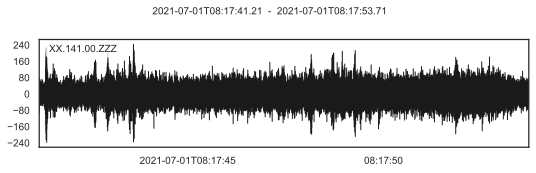

Processing complete. Data saved to "scattering_stream.mseed".


In [272]:
from obspy import UTCDateTime, Stream, Trace
import numpy as np

# Initialiser un Stream vide pour ObsPy
stream = Stream()

# Initialiser l'horodatage de départ
start_time = UTCDateTime(2021, 7, 1, 8, 17, 41)


# Parcourir chaque canal et traiter les données
for channel in range(first_channel, last_channel + 1):
    data = tdms.get_data(channel, channel, first_time_sample, last_time_sample).flatten()
   

    # Créer les métadonnées pour chaque Trace
    stats = {
        'network': 'XX',
        'station': str(channel),
        'location': '00',
        'channel': 'ZZZ',
        'npts': len(data),
        'sampling_rate': fs,
        'starttime': start_time,
        'mseed': {'dataquality': 'D'}
    }

    # Ajouter la Trace au Stream
    stream += Trace(data=data, header=stats)

    # Mettre à jour l'horodatage de départ pour la prochaine trace
    start_time += 0.01  # incrément pour simuler un petit décalage

# Fusionner les traces qui peuvent être fusionnées
stream.merge(method=1)

# Détrendre les données pour enlever la moyenne ou une tendance linéaire
stream.detrend("linear")

# Appliquer un filtre passe-bande pour isoler la bande de fréquences d'intérêt
stream.filter('bandpass', freqmin=100, freqmax=2000)

# Visualisation des données d'un canal spécifique
stream[21].plot(rasterized=True)  # Ajustez l'index en fonction du canal à visualiser

# Écriture du Stream au format MiniSEED
stream.write("scattering_stream.mseed", format="MSEED")

print('Processing complete. Data saved to "scattering_stream.mseed".')


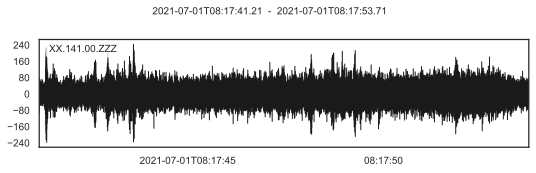

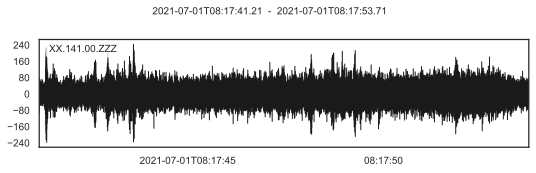

In [273]:
stream.merge(method=1)
stream[21:22].plot()  # En supposant que l'indice 12 est le canal 13


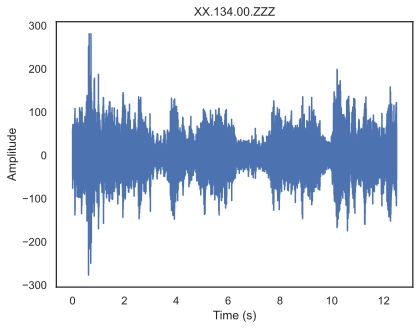

In [270]:
import matplotlib.pyplot as plt

# Supposons que stream est votre liste de traces
# Et que vous voulez tracer uniquement le canal 13, qui est à l'indice 12

trace = stream[14]  # sélectionner uniquement le canal 13
f, ax = plt.subplots()
ax.plot(trace.times(), trace.data)
ax.set_title(f"{trace.id}")
ax.set_xlabel("Time (s)")
ax.set_ylabel("Amplitude")
plt.show()


In [2]:
import pickle
import matplotlib.dates as mdates
from obspy import Stream, Trace, UTCDateTime

from matplotlib import pyplot as plt
import numpy as np
from sklearn.decomposition import FastICA,PCA

plt.rcParams["date.converter"] = "concise"
%config InlineBackend.figure_format = "svg"

# Load data from file
with np.load("scattering_coefficients11h43.npz", allow_pickle=True) as data:
    order_1 = data["order_1"]
    order_2 = data["order_2"]
    times = data["times"]

# Reshape and stack scattering coefficients of all orders
order_1 = order_1.reshape(order_1.shape[0], -1)
order_2 = order_2.reshape(order_2.shape[0], -1)
scattering_coefficients = np.hstack((order_1, order_2))

# transform into log
scattering_coefficients = np.log(scattering_coefficients)

# print info about shape
n_times, n_coeff = scattering_coefficients.shape
print_info = "Collected {} samples of {} dimensions each.".format(n_times, n_coeff)
print("Collected {} samples of {} dimensions each.".format(n_times, n_coeff))

Collected 450 samples of 728 dimensions each.


In [3]:
model = FastICA(n_components=10, whiten="unit-variance", random_state=42)
ica_features = model.fit_transform(scattering_coefficients)

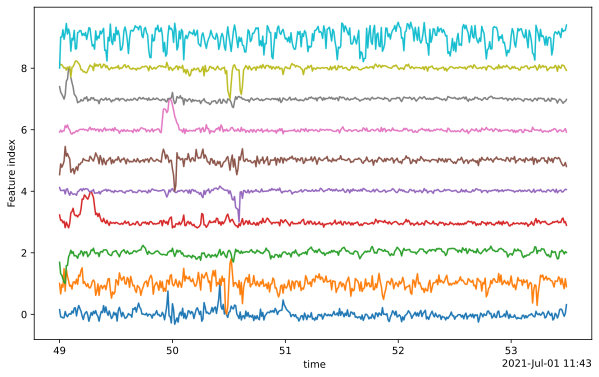

In [4]:
# Normalize the transformed features for display
features_test_normalized = ica_features / np.abs(ica_features).max(axis=0)

# Figure instance
fig = plt.figure(figsize=(10, 6), dpi=200)
ax = plt.axes()

# Plot features
ax.plot(times, features_test_normalized + np.arange(ica_features.shape[1]), rasterized=True)

# Labels
ax.set_ylabel("Feature index")
ax.set_xlabel(" time")

# Show
plt.show()


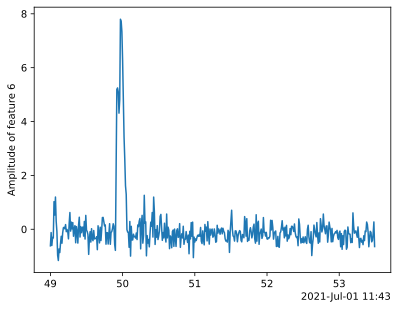

In [164]:
# Pick a feature
feature_id = 6
feature = ica_features[:, feature_id]

# Figure creation
fig = plt.figure()
ax = plt.axes()

# Plot the weights
ax.plot(times, feature)
ax.set_ylabel(f"Amplitude of feature {feature_id}")

# Show
plt.show()

In [165]:
import pandas as pd

new_file_path = 'bubble_summary.csv'
new_data = pd.read_csv(new_file_path)


new_data = new_data['Month,Date,Hour,Minute,Second,Milisec,Sampling_rate,Subsection'].str.split(',', expand=True)
new_data.columns = ['Month', 'Date', 'Hour', 'Minute', 'Second', 'Milisec', 'Sampling_rate', 'Subsection']

new_data[['Month', 'Date', 'Hour', 'Minute', 'Second']] = new_data[['Month', 'Date', 'Hour', 'Minute', 'Second']].apply(pd.to_numeric)

# Perform a test filter for July 1, 2021, from 11:43:49 to 11:43:53 to ensure correctness
test_data = new_data[
    (new_data['Date'] == 1) & 
    (new_data['Month'] == 7) & 
    (new_data['Hour'] == 11) & 
    (new_data['Minute'] == 43) & 
    (new_data['Second'] >= 49) & 
    (new_data['Second'] <= 53)
]

test_data


,Month,Date,Hour,Minute,Second,Milisec,Sampling_rate,Subsection
98857,7,1,11,43,49,459,8000,ch130_170
98858,7,1,11,43,50,216,8000,ch130_170
98859,7,1,11,43,50,687,8000,ch130_170
98860,7,1,11,43,51,7,8000,ch130_170
98861,7,1,11,43,51,696,8000,ch130_170
173430,7,1,11,43,51,65,8000,ch590_630
173431,7,1,11,43,51,366,8000,ch590_630
173432,7,1,11,43,51,817,8000,ch590_630
173433,7,1,11,43,52,48,8000,ch590_630
173434,7,1,11,43,52,186,8000,ch590_630


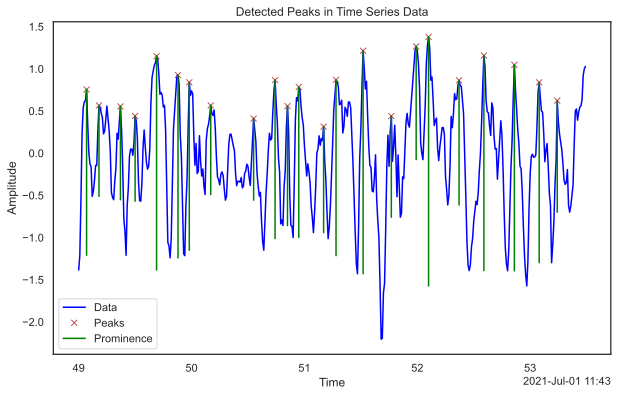

In [239]:
from scipy.ndimage import uniform_filter1d
from scipy.signal import find_peaks
# Apply a smoothing filter using a window size of 5 for the moving average
smoothed_features = uniform_filter1d(ica_features[:, 9], size=5)


def detect_and_plot_peaks(data, times, prominence=0.1, width=None, distance=None):
    """
    Detect peaks in a given time series data and plot the results with peaks marked, including prominences.
    
    Parameters:
        data (np.array): The time series data.
        times (np.array): The timestamps for the data points.
        prominence (float): The required prominence to qualify as a peak.
        width (float): The minimum width of the peaks.
        distance (float): The minimum distance between peaks.
        
    Returns:
        list: Times of the detected peaks.
        matplotlib.figure.Figure: The plot of the data with peaks and their prominences marked.
    """
    from scipy.signal import find_peaks
    import matplotlib.pyplot as plt
    
    # Detect peaks
    peaks, properties = find_peaks(data, prominence=prominence, width=width, distance=distance)
    
    # Extract the peak times
    peak_times = times[peaks]
    peak_times_str = [t.strftime('%Y-%m-%d %H:%M:%S.%f')[:-3] for t in peak_times]
    # Create the plot
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.plot(times, data, label='Data', color='blue')
    ax.plot(peak_times, data[peaks], "x", label='Peaks', color='r')
    
    # Marking the prominence on the graph
    prominences = properties['prominences']
    for i, peak in enumerate(peaks):
        ax.plot([times[peak], times[peak]], [data[peak] - prominences[i], data[peak]], color='green', label='Prominence' if i == 0 else "")
    
    ax.set_xlabel('Time')
    ax.set_ylabel('Amplitude')
    ax.set_title('Detected Peaks in Time Series Data')
    ax.legend()
    
    # Return the peak times and the plot figure
    return peak_times_str, fig


# Utilisez votre propre tableau de données et de temps ici
peak_times_str_dynamic, fig = detect_and_plot_peaks(smoothed_features, times, prominence=0.9)
plt.show()


['2021-07-01 11:43:49.070',
 '2021-07-01 11:43:49.180',
 '2021-07-01 11:43:49.370',
 '2021-07-01 11:43:49.500',
 '2021-07-01 11:43:49.690',
 '2021-07-01 11:43:49.880',
 '2021-07-01 11:43:49.980',
 '2021-07-01 11:43:50.170',
 '2021-07-01 11:43:50.550',
 '2021-07-01 11:43:50.740',
 '2021-07-01 11:43:50.850',
 '2021-07-01 11:43:50.950',
 '2021-07-01 11:43:51.170',
 '2021-07-01 11:43:51.280',
 '2021-07-01 11:43:51.520',
 '2021-07-01 11:43:51.770',
 '2021-07-01 11:43:51.990',
 '2021-07-01 11:43:52.100',
 '2021-07-01 11:43:52.370',
 '2021-07-01 11:43:52.590',
 '2021-07-01 11:43:52.860',
 '2021-07-01 11:43:53.080',
 '2021-07-01 11:43:53.240']

In [168]:
def match_with_tolerance(data_df, peak_times, tolerance_ms=30, year=2021):
    """
    Match times of detected peaks in bubble data within a specified tolerance window.

    Parameters:
        data_df (pd.DataFrame): Dataframe containing bubble data with time components.
        peak_times (list): List of datetime objects representing detected peak times.
        tolerance_ms (int): Milliseconds of tolerance before and after the peak time for matching.
        year (int): Year to adjust the date time in data if only month, day, etc., are provided.

    Returns:
        pd.DataFrame: A dataframe of matching times from the bubble data within the tolerance window.
    """
    from pandas import Timedelta
    
    # Ensure DateTime column is correctly formatted
    df = data_df.copy()
    df['DateTime'] = pd.to_datetime(df[['Month', 'Date', 'Hour', 'Minute', 'Second', 'Milisec']].astype(str).agg('-'.join, axis=1), errors='coerce', format='%m-%d-%H-%M-%S-%f')
    df['DateTime'] = df['DateTime'].apply(lambda x: x.replace(year=year))

    # Initialize an empty DataFrame to hold all matches
    all_matches = pd.DataFrame()

    # Check each peak time against the data within the tolerance window
    for peak_time in peak_times:
        lower_bound = peak_time - Timedelta(milliseconds=tolerance_ms)
        upper_bound = peak_time + Timedelta(milliseconds=tolerance_ms)
        matches = df[(df['DateTime'] >= lower_bound) & (df['DateTime'] <= upper_bound)]
        all_matches = pd.concat([all_matches, matches])

    return all_matches
    
import pandas as pd
from pandas import Timedelta

# Convertir les peak_times en datetime si ce sont des chaînes
peak_times_dt = pd.to_datetime(peak_times_str_dynamic)

# Appeler la fonction avec les peak_times convertis
matches_with_tolerance = match_with_tolerance(test_data, peak_times_dt, tolerance_ms=50)
print(matches_with_tolerance)



        Month  Date  Hour  Minute  Second Milisec Sampling_rate Subsection  \
98857       7     1    11      43      49     459          8000  ch130_170   
98858       7     1    11      43      50     216          8000  ch130_170   
173432      7     1    11      43      51     817          8000  ch590_630   
173435      7     1    11      43      52     372          8000  ch590_630   
173436      7     1    11      43      52     576          8000  ch590_630   
173437      7     1    11      43      52     847          8000  ch590_630   

                      DateTime  
98857  2021-07-01 11:43:49.459  
98858  2021-07-01 11:43:50.216  
173432 2021-07-01 11:43:51.817  
173435 2021-07-01 11:43:52.372  
173436 2021-07-01 11:43:52.576  
173437 2021-07-01 11:43:52.847  


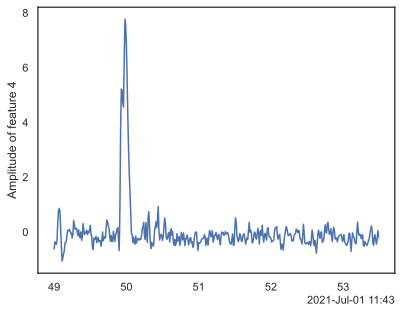

In [240]:
smoothed_features = uniform_filter1d(ica_features[:, 6], size=2)
                                    # Pick a feature

# Figure creation
fig = plt.figure()
ax = plt.axes()

# Plot the weights
ax.plot(times, smoothed_features)
ax.set_ylabel(f"Amplitude of feature {feature_id}")

# Show
plt.show()

In [241]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal


# Calculating the STFT with finer resolution
nperseg = 256  # Window length of each segment
noverlap = 192  # Overlap between windows
frequencies, times, Zxx = signal.stft(smoothed_features, fs=8000, nperseg=nperseg, noverlap=noverlap)

plt.figure(figsize=(5, 2))
plt.pcolormesh(times, frequencies, np.abs(Zxx), shading='gouraud', cmap='viridis', vmin=0, vmax=np.abs(Zxx).max()/2)
plt.colorbar(label='Normalized Spectral Amplitude')
plt.yscale('symlog', linthresh=1, linscale=1)  # Improved symlog scaling
plt.ylabel('Frequency [Hz]')
plt.xlabel('Time [sec]')
plt.title('Spectrogram of Feature 6')
plt.ylim(1, frequencies.max())  # Ignore too low frequencies
plt.grid(True, which='both', linestyle='--', linewidth=0.5)
plt.show()


In [242]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.ndimage import uniform_filter1d

# Définir la fréquence d'échantillonnage
fs = 8000  # Fréquence d'échantillonnage

# Calcul de la STFT
frequencies, times, Zxx = signal.stft(smoothed_features, fs=fs, nperseg=256, noverlap=128)

# Création de la figure avec des subplots
fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, figsize=(5, 3))

# Spectrogramme sur le premier axe
pcm = ax1.pcolormesh(times, frequencies, np.abs(Zxx), shading='gouraud', cmap='viridis', vmin=0, vmax=np.abs(Zxx).max()/2)
fig.colorbar(pcm, ax=ax1, label='Normalized Spectral Amplitude')
ax1.set_yscale('symlog', linthresh=1.0)
ax1.set_ylabel('Frequency [Hz]')
ax1.set_xlabel('Time [sec]')
ax1.set_title('Spectrogram of Feature 6')
ax1.set_ylim(1, frequencies.max())

# Tracé de smoothed_features sur le deuxième axe
ax2.plot(np.linspace(0, len(smoothed_features) / fs, num=len(smoothed_features)), smoothed_features, 'k')
ax2.set_xlabel('Time [sec]')
ax2.set_ylabel(f"Amplitude of feature {feature_id}")
ax2.set_title(f'Time Series of Feature {feature_id}')

plt.tight_layout()
plt.show()


In [274]:
import numpy as np
import matplotlib.pyplot as plt
from scipy import signal
from scipy.ndimage import uniform_filter1d
from obspy import Stream  # Assurez-vous que Stream est correctement importé

# Supposons que 'smoothed_features' et 'feature_id' sont déjà définis
# Définir la fréquence d'échantillonnage
fs = 8000  # Fréquence d'échantillonnage

# Calcul de la STFT
frequencies, times, Zxx = signal.stft(smoothed_features, fs=fs, nperseg=256, noverlap=128)

# Création de la figure avec des subplots
fig, (ax1, ax2, ax3) = plt.subplots(nrows=1, ncols=3, figsize=(15, 3))  # Ajuster la taille et le nombre de subplots

# Spectrogramme sur le premier axe
pcm = ax1.pcolormesh(times, frequencies, np.abs(Zxx), shading='gouraud', cmap='viridis', vmin=0, vmax=np.abs(Zxx).max()/2)
fig.colorbar(pcm, ax=ax1, label='Normalized Spectral Amplitude')
ax1.set_yscale('symlog', linthresh=1.0)
ax1.set_ylabel('Frequency [Hz]')
ax1.set_xlabel('Time [sec]')
ax1.set_title('Spectrogram of Feature 6')
ax1.set_ylim(1, frequencies.max())

# Tracé de smoothed_features sur le deuxième axe
ax2.plot(np.linspace(0, len(smoothed_features) / fs, num=len(smoothed_features)), smoothed_features, 'k')
ax2.set_xlabel('Time [sec]')
ax2.set_ylabel(f"Amplitude of feature {feature_id}")
ax2.set_title(f'Time Series of Feature {feature_id}')

# Tracé de la trace stream[21] sur le troisième axe
trace = stream[14]  # Obtenir la trace désirée
times = np.arange(0, trace.stats.npts / trace.stats.sampling_rate, 1/trace.stats.sampling_rate)
ax3.plot(times, trace.data, 'b')
ax3.set_xlabel('Time [sec]')
ax3.set_ylabel('Amplitude')
ax3.set_title(f'Trace {trace.id}')

plt.tight_layout()
plt.show()


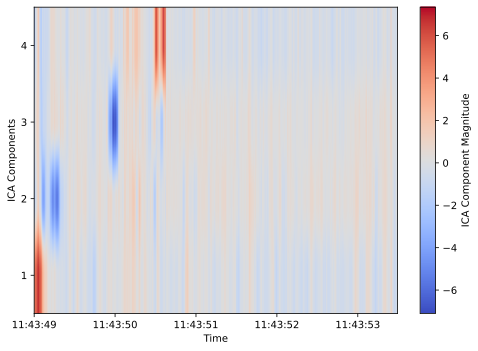

In [11]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from sklearn.decomposition import FastICA
import numpy as np


# Convertir les datetime.datetime en format numérique pour Matplotlib
times_num = mdates.date2num(times)

# Application de l'ICA sur les coefficients de diffusion
model_ica = FastICA(n_components=4, random_state=42)
# Reshape scattering_coefficients si nécessaire pour l'ICA
ica_features = model_ica.fit_transform(scattering_coefficients)

# Trouver l'indice de la valeur maximale absolue pour chaque caractéristique
max_abs_indices = np.argmax(np.abs(ica_features), axis=0)
# Trier les indices par ces valeurs maximales absolues pour ordonner les composants
sorted_indices = np.argsort(max_abs_indices)

# Trier les caractéristiques
sorted_ica_features = ica_features[:, sorted_indices]

# Création de la figure et des axes pour la heatmap
fig, ax = plt.subplots(figsize=(7, 5))

# Affichage des composants ICA triés sur une seule heatmap
cax = ax.imshow(sorted_ica_features.T, aspect='auto', cmap='coolwarm', origin='lower',
                extent=[times_num[0], times_num[-1], 0, 4])  # On utilise '4' pour l'axe des y car il y a 4 composants

# Ajouter une barre de couleur pour l'amplitude
cbar = fig.colorbar(cax, ax=ax, orientation='vertical')
cbar.set_label('ICA Component Magnitude')

# Configurer les échelles et les étiquettes
ax.set_xlabel("Time")
ax.set_ylabel("ICA Components")
ax.set_yticks([0.5, 1.5, 2.5, 3.5])  # Centrer les étiquettes sur chaque composant
ax.set_yticklabels([1, 2, 3, 4])  # Étiquettes des composants

# Formater l'axe des x pour afficher les dates
ax.xaxis_date()
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))


plt.tight_layout()  
plt.show()


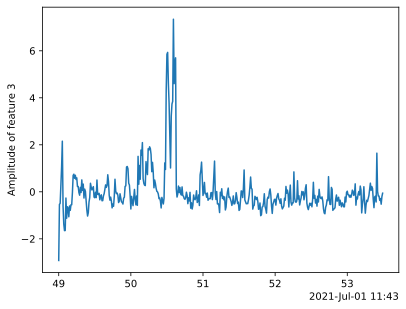

In [13]:
# Sélectionnez l'ID de la caractéristique que vous souhaitez afficher, par exemple la première caractéristique triée
feature_id = 3 # Python utilise un index à partir de 0, donc 0 correspond à la première caractéristique

# Créez la figure et les axes
fig, ax = plt.subplots()

# Tracer la caractéristique sélectionnée
# Nous supposons ici que `times` est une liste ou un tableau numpy de `datetime.datetime`
ax.plot(times, sorted_ica_features[:, feature_id])
ax.set_ylabel(f"Amplitude of feature {feature_id}")  # +1 pour afficher un numéro de fonction basé sur 1

plt.show()


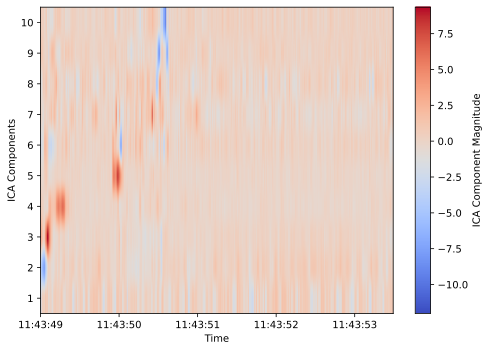

In [7]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from sklearn.decomposition import FastICA
import numpy as np


# Convertir les datetime.datetime en format numérique pour Matplotlib
times_num = mdates.date2num(times)

# Application de l'ICA sur les coefficients de diffusion
model_ica = FastICA(n_components=10, random_state=42)
# Reshape scattering_coefficients si nécessaire pour l'ICA
ica_features = model_ica.fit_transform(scattering_coefficients)

# Trouver l'indice de la valeur maximale absolue pour chaque caractéristique
max_abs_indices = np.argmax(np.abs(ica_features), axis=0)
# Trier les indices par ces valeurs maximales absolues pour ordonner les composants
sorted_indices = np.argsort(max_abs_indices)

# Trier les caractéristiques
sorted_ica_feature = ica_features[:, sorted_indices]

# Création de la figure et des axes pour la heatmap
fig, ax = plt.subplots(figsize=(7, 5))

# Affichage des composants ICA triés sur une seule heatmap
cax = ax.imshow(sorted_ica_feature.T, aspect='auto', cmap='coolwarm', origin='lower',
                extent=[times_num[0], times_num[-1], 0, 10])  # On utilise '4' pour l'axe des y car il y a 4 composants

# Ajouter une barre de couleur pour l'amplitude
cbar = fig.colorbar(cax, ax=ax, orientation='vertical')
cbar.set_label('ICA Component Magnitude')

# Configurer les échelles et les étiquettes
ax.set_xlabel("Time")
ax.set_ylabel("ICA Components")
ax.set_yticks(np.arange(0.5, 10, 1))
ax.set_yticklabels(np.arange(1, 11))
# Formater l'axe des x pour afficher les dates
ax.xaxis_date()
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))


plt.tight_layout()  
plt.show()


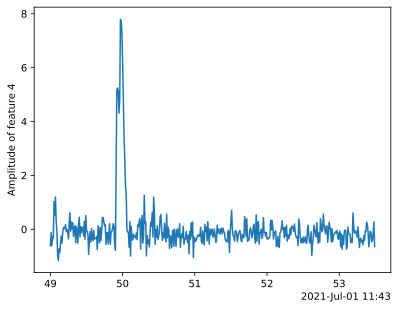

In [8]:
# Sélectionnez l'ID de la caractéristique que vous souhaitez afficher, par exemple la première caractéristique triée
feature_id = 4 # Python utilise un index à partir de 0, donc 0 correspond à la première caractéristique

# Créez la figure et les axes
fig, ax = plt.subplots()

# Tracer la caractéristique sélectionnée
# Nous supposons ici que `times` est une liste ou un tableau numpy de `datetime.datetime`
ax.plot(times, sorted_ica_feature[:, feature_id])
ax.set_ylabel(f"Amplitude of feature {feature_id}")  # +1 pour afficher un numéro de fonction basé sur 1

plt.show()


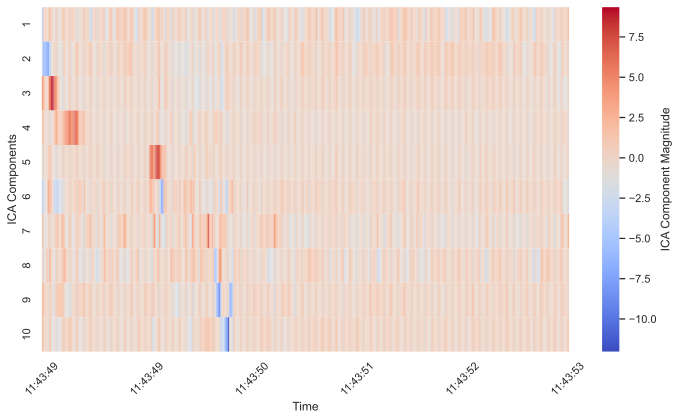

In [234]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from sklearn.decomposition import FastICA
import numpy as np

# Assumons que 'times' et 'scattering_coefficients' sont correctement définis et formatés
times_num = mdates.date2num(times)  # Convertir datetime en format numérique pour Matplotlib

# Application de l'ICA avec 10 composants
model_ica = FastICA(n_components=10, random_state=42)
ica_features = model_ica.fit_transform(scattering_coefficients.reshape(-1, scattering_coefficients.shape[-1]))

# Trouver l'indice de la valeur maximale absolue pour chaque caractéristique
max_abs_indices = np.argmax(np.abs(ica_features), axis=0)
# Trier les indices par ces valeurs maximales absolues pour ordonner les composants
sorted_indices = np.argsort(max_abs_indices)
# Trier les caractéristiques
sorted_ica_features = ica_features[:, sorted_indices]

# Création de la figure et des axes pour la heatmap
fig, ax = plt.subplots(figsize=(10, 6))

# Utiliser seaborn pour créer la heatmap des composants ICA triés
sns.heatmap(sorted_ica_features.T, ax=ax, cmap="coolwarm", cbar_kws={'label': 'ICA Component Magnitude'},
            xticklabels=False)

# Configurer les échelles et les étiquettes
ax.set_xlabel("Time")
ax.set_ylabel("ICA Components")
ax.set_yticks(np.arange(0.5, 10, 1))  # Position des étiquettes pour chaque composant
ax.set_yticklabels(np.arange(1, 11))  # Étiquettes pour les composants dans l'ordre croissant

# Formater l'axe des x pour afficher les dates
xtick_locs = np.linspace(0, len(times_num) - 1, num=6)  # Définir 6 positions pour les labels sur l'axe des x
xtick_labels = [mdates.num2date(times_num[int(loc)]).strftime('%H:%M:%S') for loc in xtick_locs]
ax.set_xticks(xtick_locs)
ax.set_xticklabels(xtick_labels, rotation=45)  # Appliquer les labels formatés avec rotation

plt.tight_layout()
plt.show()


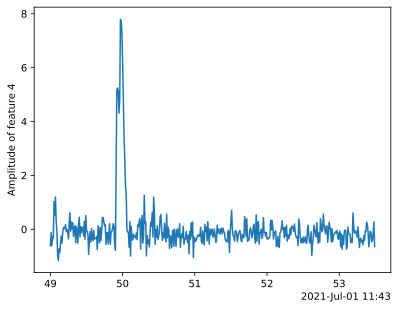

In [219]:
# Sélectionnez l'ID de la caractéristique que vous souhaitez afficher, par exemple la première caractéristique triée
feature_id = 4 # Python utilise un index à partir de 0, donc 0 correspond à la première caractéristique

# Créez la figure et les axes
fig, ax = plt.subplots()

# Tracer la caractéristique sélectionnée
# Nous supposons ici que `times` est une liste ou un tableau numpy de `datetime.datetime`
ax.plot(times, sorted_ica_feature[:, feature_id])
ax.set_ylabel(f"Amplitude of feature {feature_id}")  # +1 pour afficher un numéro de fonction basé sur 1

plt.show()


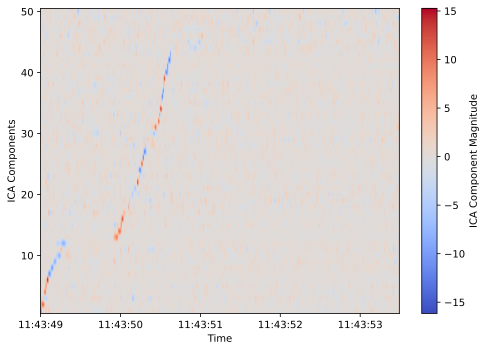

In [227]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from sklearn.decomposition import FastICA
import numpy as np


times_num = mdates.date2num(times)

# Application de l'ICA sur les coefficients de diffusion
model_ica = FastICA(n_components=50, random_state=42)
# Reshape scattering_coefficients si nécessaire pour l'ICA
ica_features = model_ica.fit_transform(scattering_coefficients.reshape(-1, scattering_coefficients.shape[-1]))

# Trouver l'indice de la valeur maximale absolue pour chaque caractéristique
max_abs_indices = np.argmax(np.abs(ica_features), axis=0)
# Trier les indices par ces valeurs maximales absolues pour ordonner les composants
sorted_indices = np.argsort(max_abs_indices)

# Trier les caractéristiques
sorted_ica_features = ica_features[:, sorted_indices]

# Création de la figure et des axes pour la heatmap
fig, ax = plt.subplots(figsize=(7, 5))

# Affichage des composants ICA triés sur une seule heatmap
cax = ax.imshow(sorted_ica_features.T, aspect='auto', cmap='coolwarm', origin='lower',
                extent=[times_num[0], times_num[-1], 0, 50])  # On utilise '4' pour l'axe des y car il y a 4 composants

# Ajouter une barre de couleur pour l'amplitude
cbar = fig.colorbar(cax, ax=ax, orientation='vertical')
cbar.set_label('ICA Component Magnitude')

# Configurer les échelles et les étiquettes
ax.set_xlabel("Time")
ax.set_ylabel("ICA Components")
ax.set_yticks(np.arange(9.5, 50, 10))
# Définir les étiquettes des ticks pour 10, 20, 30, 40, et 50
ax.set_yticklabels(np.arange(10, 51, 10))

ax.xaxis_date()
ax.xaxis.set_major_formatter(mdates.DateFormatter('%H:%M:%S'))

plt.tight_layout()  # Ajuster automatiquement les sous-tracés
plt.show()


In [231]:
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import numpy as np

# Configuration de Seaborn pour un meilleur style de plot
sns.set(style="white")

# Création de la figure et des axes pour la heatmap
fig, ax = plt.subplots(figsize=(7, 5))

# Inverser les données le long de l'axe des y pour afficher le premier composant en haut
ica_features_flipped = sorted_ica_features.T[::-1]

# Utiliser Seaborn pour créer la heatmap
sns.heatmap(ica_features_flipped, ax=ax, cmap="coolwarm", cbar_kws={'label': 'ICA Component Magnitude'})

# Configurer les échelles et les étiquettes
ax.set_xlabel("Time")
ax.set_ylabel("ICA Components")
# Ajuster les ticks et labels pour refléter l'inversion
ax.set_yticks(np.arange(0.5, len(ica_features_flipped), 10))  # Position des étiquettes pour chaque 10ème composant
ax.set_yticklabels(np.arange(50, 9, -10))  # Étiquettes pour les composants, inversées

# Formater l'axe des x pour afficher les dates
xticklabels = mdates.num2date(times_num)  # Convertir les numéros de date en objets datetime
ax.set_xticks(np.linspace(0, len(times_num)-1, num=10))  # Placer des ticks à des intervalles réguliers


plt.tight_layout()  # Ajuster automatiquement les sous-tracés
plt.show()


In [175]:
# Save the features

# Load the scattering network
network = pickle.load(open("network/scattering_network.pickle", "rb"))

np.savez(
    "independent_components.npz",
    features=ica_features,
    times=times,
)

# Save the dimension reduction model
with open("dimension_model.pickle", "wb") as pickle_file:
    pickle.dump(
        model,
        pickle_file,
        protocol=pickle.HIGHEST_PROTOCOL,
    )

n_cha = 3


# Load the dimensionality reduction model
dimension_model = pickle.load(open("dimension_model.pickle", "rb"))


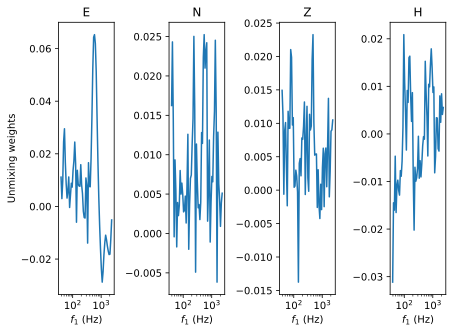

In [176]:
# Etract weights from the dimensionality reduction model
feature_id = 6
weights = dimension_model.components_[feature_id]
vmax = np.abs(weights).max()

# Scattering coefficients shape and frequencies
n_cha = 4
n_order_1 = network.banks[0].octaves * network.banks[0].resolution
f_1 = network.banks[0].centers

# Extract and reshape weights
order_1 = weights[: n_cha * n_order_1].reshape(n_cha, n_order_1)

# Show weights
fig, ax = plt.subplots(nrows=1, ncols=4, sharex=True)  # Modify number of rows to 1
for id, channel in enumerate("ENZH"):
    ax[id].plot(f_1, order_1[id], label=channel)
    ax[id].set_title(channel)
    ax[id].set_xlabel("$f_1$ (Hz)")

# Labels
ax[0].set_ylabel("Unmixing weights")
ax[0].set_xscale("log")

plt.tight_layout()
plt.show()

In [226]:
# Filter out latent space
import matplotlib.dates as mdates
features_filtered = np.zeros(ica_features.shape)
features_filtered[:, feature_id] = feature

# Extract all scattering coefficients
reconstructed = dimension_model.inverse_transform(features_filtered)
reconstructed_order_1 = reconstructed[:, : n_cha * n_order_1].reshape(-1, n_cha, n_order_1)

# Check for object type and convert to float64 if necessary
if reconstructed_order_1.dtype == 'O':
    reconstructed_order_1 = reconstructed_order_1.astype(np.float64)

vmin = reconstructed_order_1.min()
vmax = reconstructed_order_1.max()
times_float =times


# Plot
fig, ax = plt.subplots(nrows=4, sharex=True, sharey="row")

# Plot
for id, channel in enumerate("ENZH"):
    data = reconstructed_order_1[:, id, :].squeeze().T
    mappable = ax[id].pcolormesh(times_float, f_1, data, rasterized=True, vmin=vmin, vmax=vmax)
    ax[id].set_ylabel("$f_1$ (Hz)")
    ax[id].set_yscale("log")

# Colorbar
colorbar = fig.colorbar(mappable, orientation="vertical", ax=ax, shrink=0.5)
colorbar.set_label("Reconstruction")  # Modifié "Scattering coefficients" à "Reconstruction"


IndexError: index 4 is out of bounds for axis 1 with size 4